In [ ]:
# Investigating how accuracy improves at different distances

In [1]:
import rtde_control
import rtde_receive
import numpy as np
import spatialmath as sm
robotIP = "192.168.0.4"
con = rtde_control.RTDEControlInterface(robotIP)
rec = rtde_receive.RTDEReceiveInterface(robotIP)

from magpie import realsense_wrapper as real
rsc = real.RealSense()
rsc.initConnection()

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [2]:
from block_task.Motor_Code import Motors
import block_task.UR5_Interface as ur
servoPort = "/dev/ttyACM0"
gripperController = Motors(servoPort)
gripperController.torquelimit(600) # used to be 600
gripperController.speedlimit(100)
ur = ur.UR5_Interface()
ur.gripperController = gripperController

Succeeded to open the port
Succeeded to change the baudrate
Moving speed of dxl ID: 1 set to 100 
Moving speed of dxl ID: 2 set to 100 
Moving speed of dxl ID: 1 set to 100 
Moving speed of dxl ID: 2 set to 100 


In [3]:
try:
    ur.c = con
    ur.r = rec
    ur.gripperController = gripperController
except Exception as e:
    raise(e)
else:
    print("UR5 + Gripper Interface Established")

UR5 + Gripper Interface Established


In [49]:

# np.save("homepose",np.array(ur.getPose()))

pass


<class 'numpy.ndarray'>


In [6]:
home_pose = np.load("homepose.npy")
home_pose = sm.SE3(home_pose)
ur.moveL(home_pose)

[[ 0.14794653  0.10599234  0.98329927  0.40110553]
 [ 0.68478407  0.70637623 -0.17917423 -0.40860592]
 [-0.71357032  0.69985588  0.03192405  0.22408838]
 [ 0.          0.          0.          1.        ]]
[ 0.40110553 -0.40860592  0.22408838]
[ 0.01498893 -0.57686779  0.05545535]
[ 0.40110553 -0.40860592  0.22408838]


In [5]:
from magpie.perception.label_owlvit import LabelOWLViT
path = "google/owlvit-base-patch32"
label_vit = LabelOWLViT(path)

In [6]:
from magpie.perception.mask_sam import MaskSAM
ckpt = "/home/streck/work/owlvit_segment_anything/sam_vit_h_4b8939.pth"
mask_sam = MaskSAM(ckpt)

Incrementing robot forward
['blueBlock' 'blueBlock']
[0.11584038, 0.13173068]
Incrementing robot forward
['blueBlock' 'blueBlock']
[0.1059188, 0.13736904]
Incrementing robot forward
['blueBlock']
[0.124739744]
Incrementing robot forward
['blueBlock' 'blueBlock']
[0.11354514, 0.12000307]
Incrementing robot forward
['blueBlock' 'blueBlock']
[0.12818131, 0.13040371]
Incrementing robot forward
['blueBlock' 'blueBlock']
[0.11192404, 0.11800049]
Incrementing robot forward
['blueBlock' 'blueBlock']
[0.12414443, 0.120256655]
Incrementing robot forward
['blueBlock' 'blueBlock']
[0.12098895, 0.120734334]
Incrementing robot forward
['blueBlock' 'blueBlock']
[0.13207719, 0.12492721]
Incrementing robot forward
['blueBlock' 'blueBlock']
[0.1334027, 0.116775006]
Incrementing robot forward
['blueBlock' 'blueBlock']
[0.13574867, 0.11600155]
Incrementing robot forward
['blueBlock' 'blueBlock']
[0.14487204, 0.12436454]
Incrementing robot forward
['blueBlock' 'blueBlock']
[0.14712635, 0.122988865]
Increme

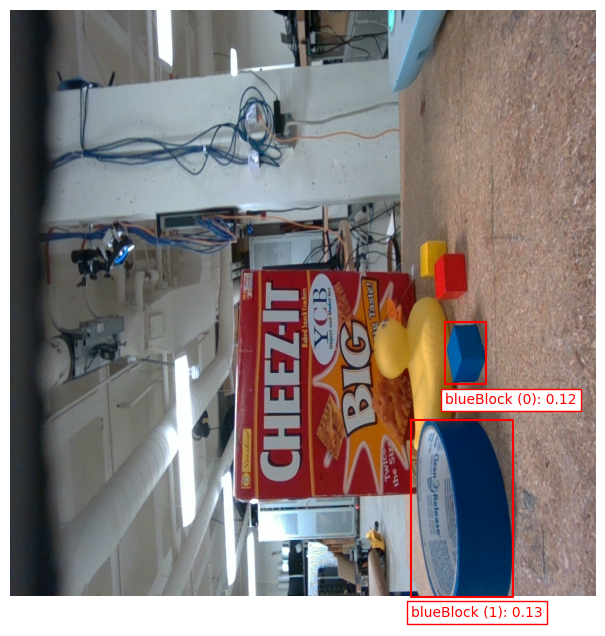

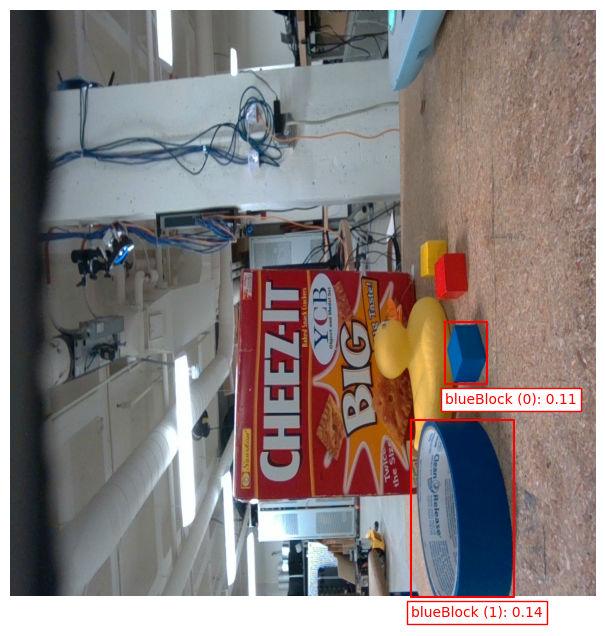

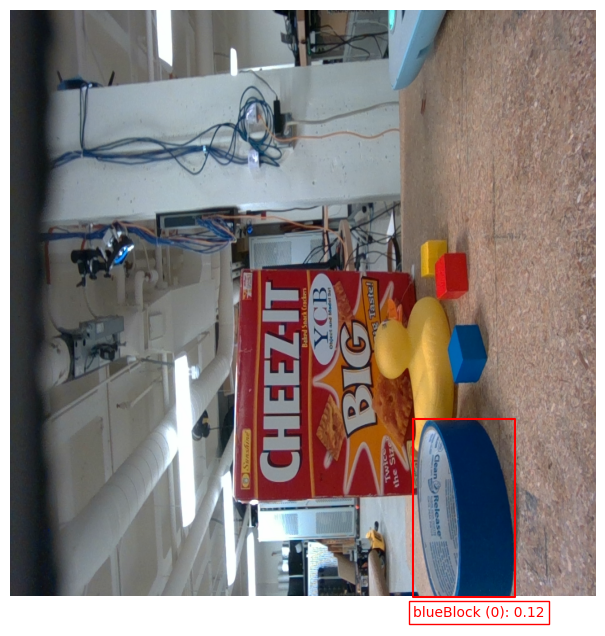

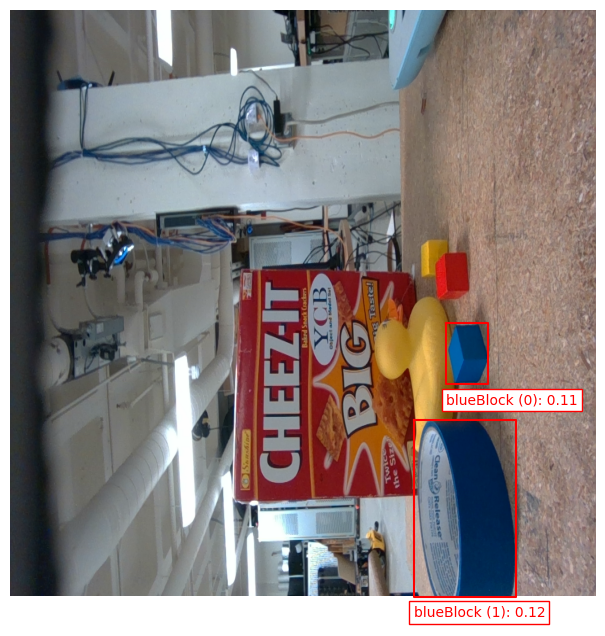

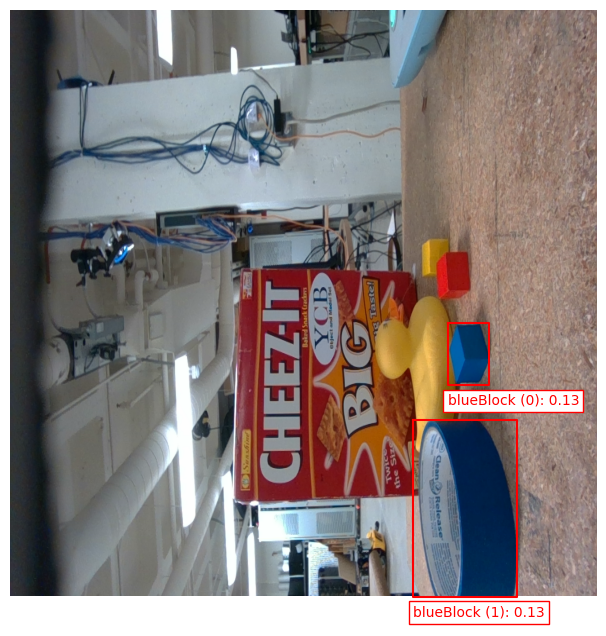

...

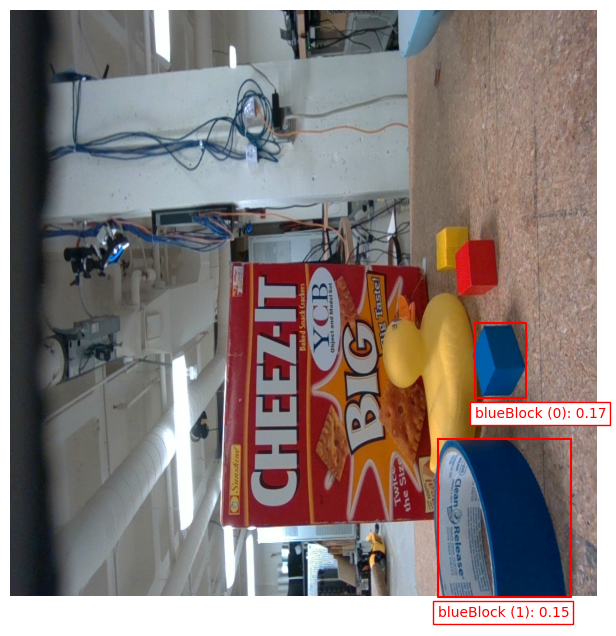

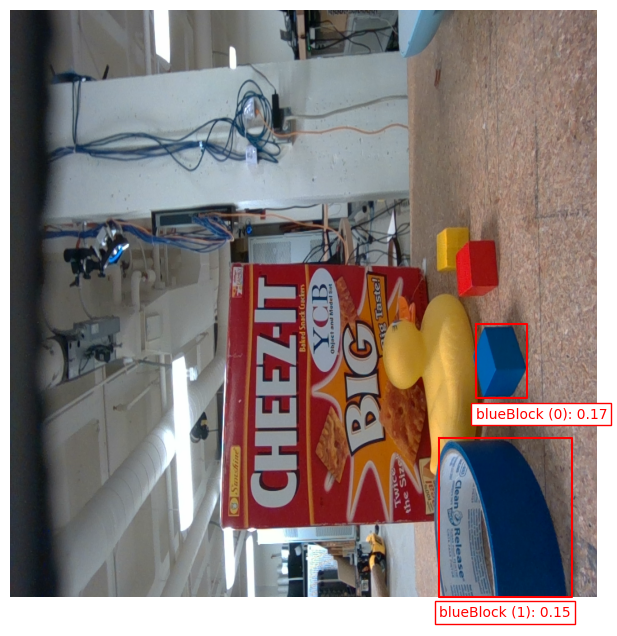

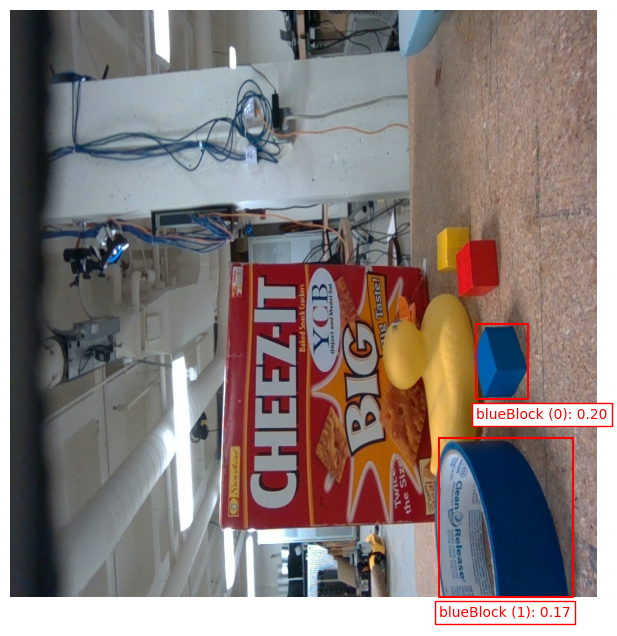

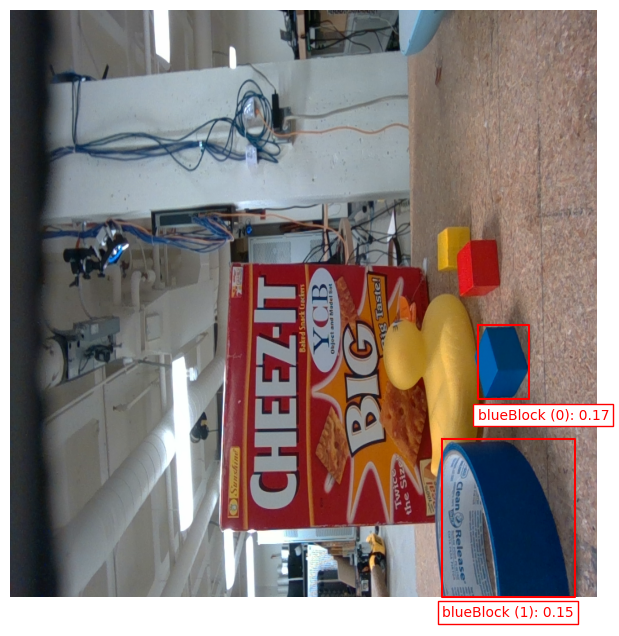

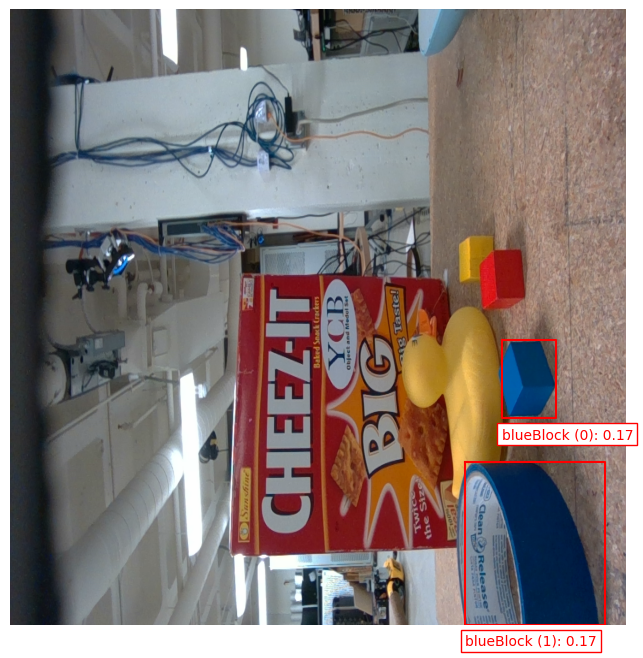

In [11]:
# Test move forward
import time
sleep_rate = 0.75
increm = 1/1000 # 1cm

queries = ["a photo of a blue cube"]
abbrevq = ["blueBlock"]

label_vit.set_threshold(0.1)

confidences = []
for x in range(0,50):
    initPose = np.array(ur.getPose())

    dX, dY, dZ = 0, -1*increm, 0 # may need to switch increm to dY
    goalPose = initPose
    goalPose[1][3] += dY 
    goalPose = sm.SE3(goalPose)

    print('Incrementing robot forward')
    ur.moveL(sm.SE3(goalPose))
    time.sleep(sleep_rate)
    p, rgbd_image = rsc.getPCD()
    image = np.array(rgbd_image.color)
    bboxes, uboxes, scores = label_vit.label(image, queries, abbrevq, plot=True)
    print(label_vit.labels)
    print(scores)


In [9]:
ur.moveL(sm.SE3(home_pose))


ValueError: bad argument to constructor

Incrementing robot
MoveJ to:
 [[ -83.84119042]
 [-100.65189789]
 [-126.48697915]
 [-130.64746594]
 [ -77.28268978]
 [   0.64935211]]
['redBlock']
[0.14414577]
Incrementing robot
MoveJ to:
 [[ -80.17979921]
 [-101.92999021]
 [-124.81407457]
 [-131.02768891]
 [ -70.77332826]
 [   0.49886944]]
['redBlock']
[0.1729134]
Incrementing robot
MoveJ to:
 [[ -76.82562992]
 [-103.40533839]
 [-122.83730854]
 [-131.50689498]
 [ -64.56607966]
 [   0.35731316]]
['redBlock']
[0.2326484]
Incrementing robot
MoveJ to:
 [[ -73.76004977]
 [-105.04769836]
 [-120.56362053]
 [-132.09401804]
 [ -58.65597162]
 [   0.2143836 ]]
['redBlock']
[0.21246354]
Incrementing robot
MoveJ to:
 [[-7.09803540e+01]
 [-1.06838574e+02]
 [-1.18017053e+02]
 [-1.32794604e+02]
 [-5.30182515e+01]
 [ 8.52084175e-02]]
['redBlock']
[0.20409201]
MoveJ to:
 [[ -87.80294603]
 [ -99.60261691]
 [-127.83137894]
 [-130.35322139]
 [ -84.09792357]
 [   0.80393317]]
Incrementing robot
MoveJ to:
 [[ -91.88220821]
 [-102.19934555]
 [-124.45734745]


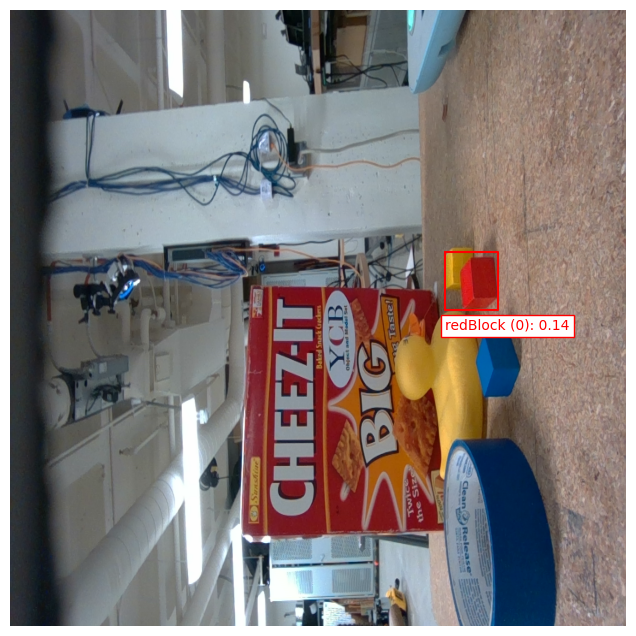

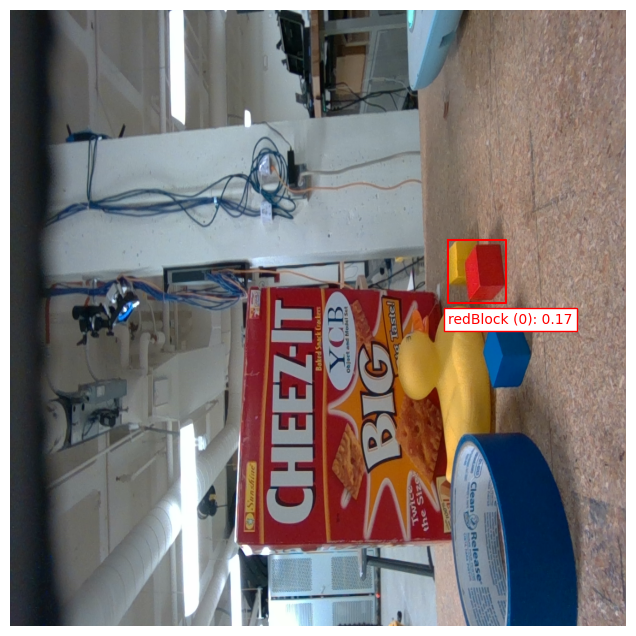

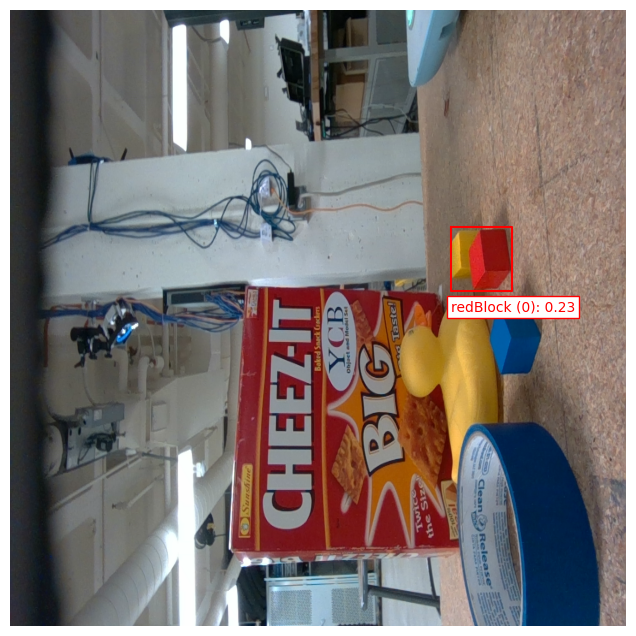

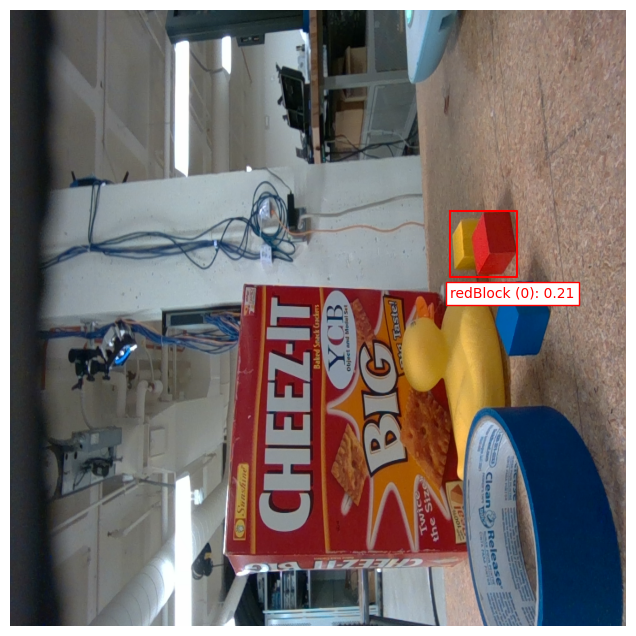

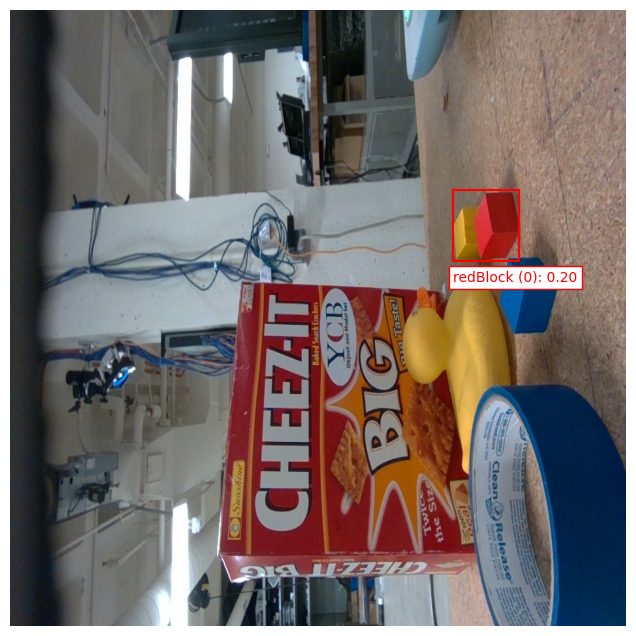

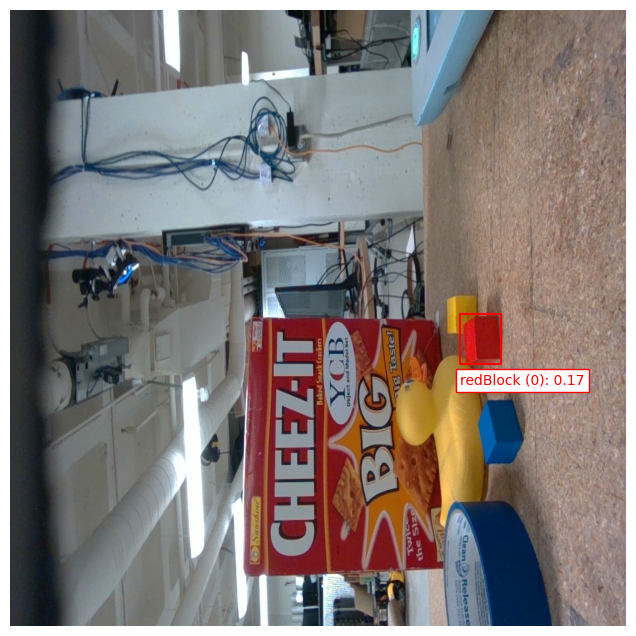

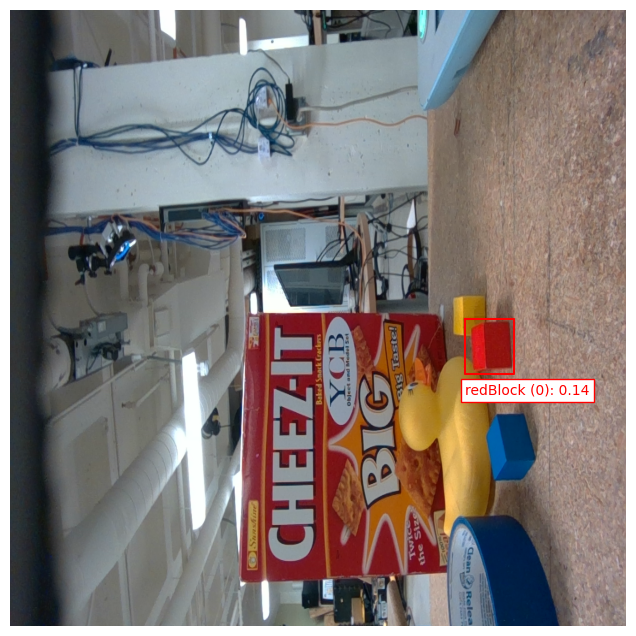

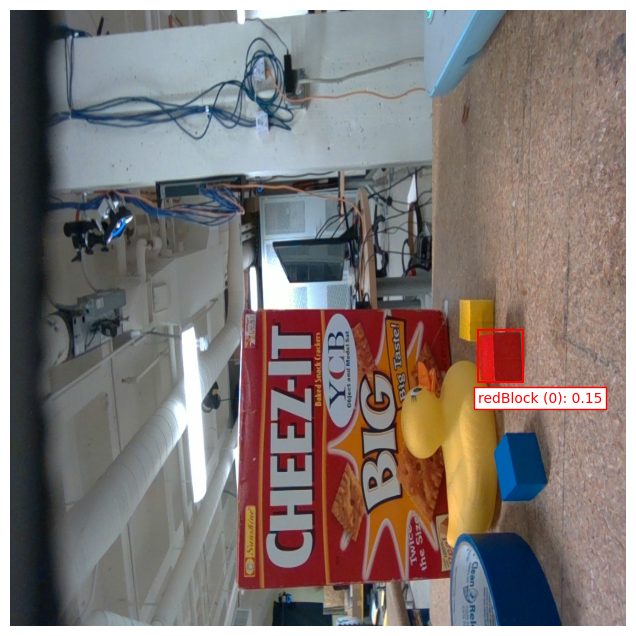

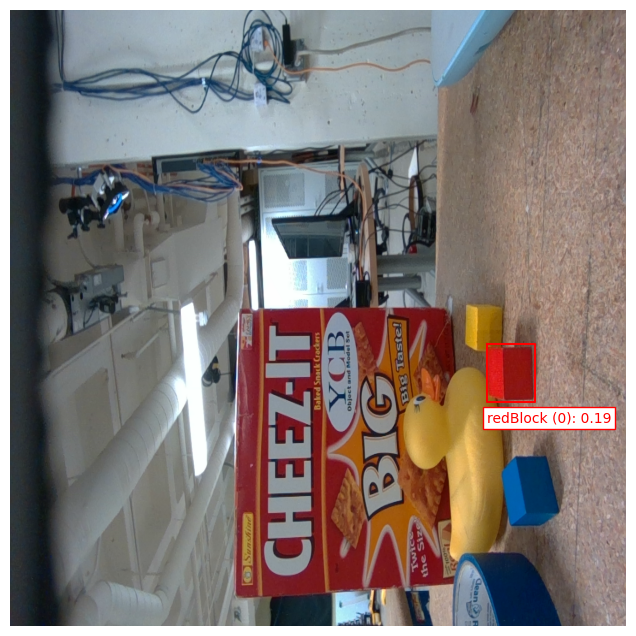

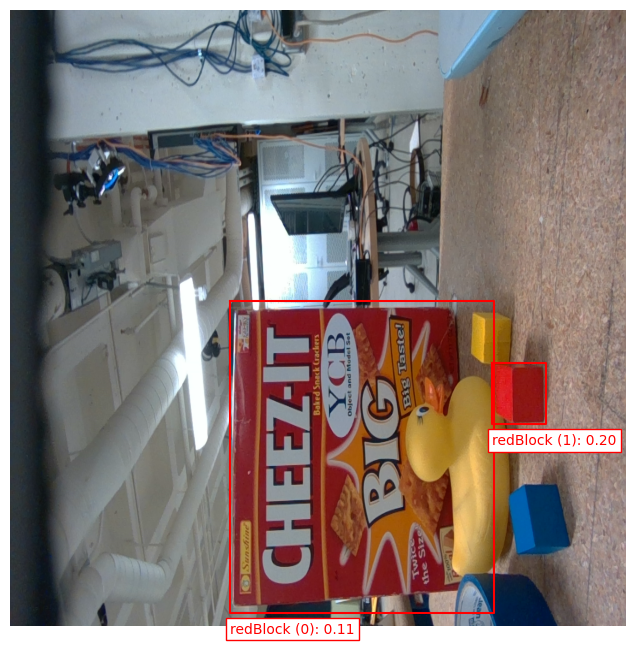

In [15]:
#rotate around object
#jAngle = ur.getJointAngles()
#jAngle[4] += 0.1
#ur.moveJ(jAngle)

incremx = 25/1000 
incremy = 15/1000
angle = 5/100

queries = ["a photo of a red cube"]
abbrevq = ["redBlock"]

label_vit.set_threshold(0.1)
home_pose = np.array(ur.getPose())
home_pose = sm.SE3(home_pose)
home_angle = ur.getJointAngles()
queries = ["a photo of a red cube"]
abbrevq = ["redBlock"]

label_vit.set_threshold(0.1)
for x in range(0,5):
    time.sleep(1)
    initPose = np.array(ur.getPose())

    dX, dY, dZ = incremx, -incremy, 0 # may need to switch increm to dY
    goalPose = initPose
    goalPose[0][3] += dX
    goalPose[1][3] += dY 
    goalPose = sm.SE3(goalPose)



    print('Incrementing robot')
    ur.moveL(sm.SE3(goalPose))
    time.sleep(sleep_rate)
    jAngles = ur.getJointAngles()
    jAngles[4] += angle # scalar is a weight for angle of rotation
    ur.moveJ(jAngles)
    time.sleep(sleep_rate)
    p, rgbd_image = rsc.getPCD()
    image = np.array(rgbd_image.color)
    bboxes, uboxes, scores = label_vit.label(image, queries, abbrevq, plot=True)
    print(label_vit.labels)
    print(scores)

ur.moveL(sm.SE3(home_pose))
time.sleep(sleep_rate)
ur.moveJ(home_angle)
time.sleep(sleep_rate)
for x in range(0,5): # does the opposite of first loop
    time.sleep(1)
    initPose = np.array(ur.getPose())

    dX, dY, dZ = -incremx, -incremy, 0 # may need to switch increm to dY
    goalPose = initPose
    goalPose[0][3] += dX
    goalPose[1][3] += dY 
    goalPose = sm.SE3(goalPose)



    print('Incrementing robot')
    time.sleep(sleep_rate)
    ur.moveL(sm.SE3(goalPose))
    time.sleep(sleep_rate)
    jAngles = ur.getJointAngles()
    jAngles[4] -= angle # scalar is a weight for angle of rotation
    ur.moveJ(jAngles)

    p, rgbd_image = rsc.getPCD()
    image = np.array(rgbd_image.color)
    bboxes, uboxes, scores = label_vit.label(image, queries, abbrevq, plot=True) # conditional to not repeat angles when readjusting
    print(label_vit.labels)
    print(scores)

ur.moveL(sm.SE3(home_pose))
time.sleep(sleep_rate)
ur.moveJ(home_angle)

Incrementing robot forward
MoveJ to:
 [[ -69.52112509]
 [ -91.18443608]
 [-132.98475667]
 [-137.28905992]
 [ -74.6412316 ]
 [   0.72696451]]
Incrementing robot forward
MoveJ to:
 [[ -69.52180811]
 [ -91.18580212]
 [-132.98201093]
 [-137.28769388]
 [ -73.21079874]
 [   0.72353128]]
Incrementing robot forward
MoveJ to:
 [[ -69.52593354]
 [ -91.1851191 ]
 [-132.97994822]
 [-137.2883769 ]
 [ -71.77968287]
 [   0.72147133]]


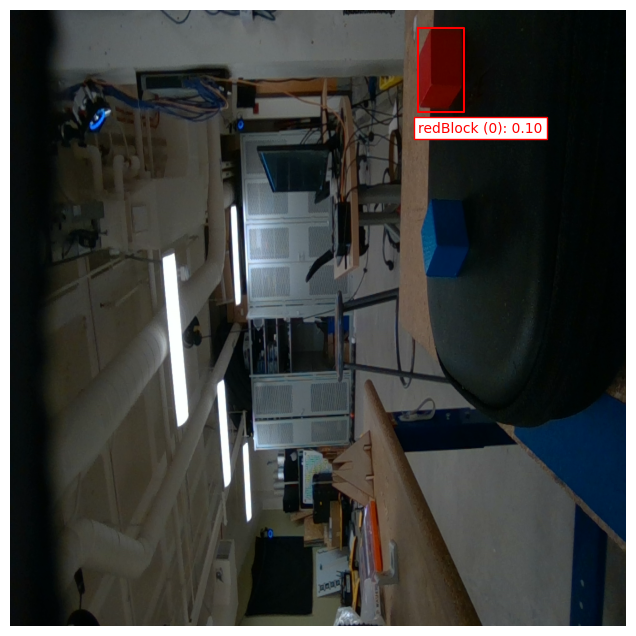

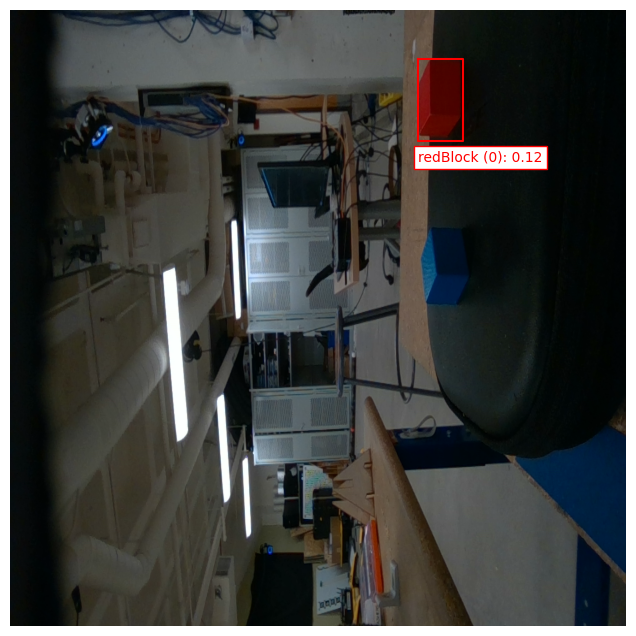

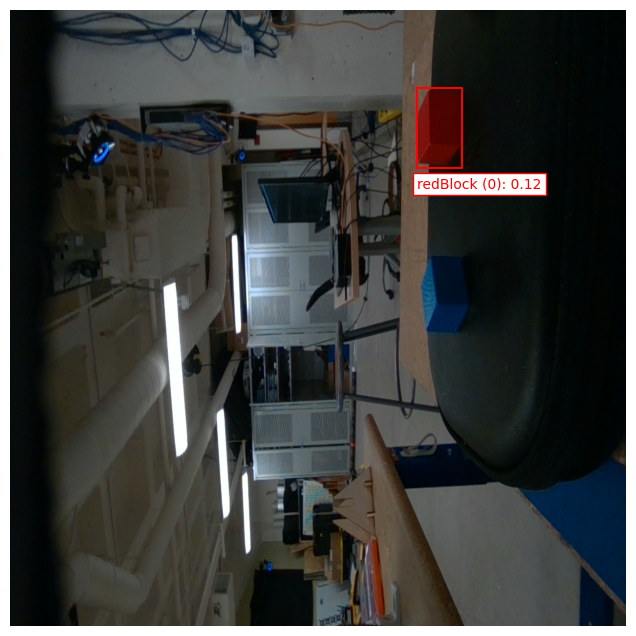

In [22]:
for x in range(0,3): # does the opposite of first loop
    time.sleep(1)
    initPose = np.array(ur.getPose())

    dX, dY, dZ = increm, increm, 0 # may need to switch increm to dY
    goalPose = initPose
    goalPose[0][3] += dX
    goalPose[1][3] += dY 
    goalPose = sm.SE3(goalPose)

    jAngles = ur.getJointAngles()
    jAngles[4] += increm*25 # scalar is a weight for angle of rotation

    print('Incrementing robot forward')
    ur.moveL(sm.SE3(goalPose))
    ur.moveJ(jAngles)

    p, rgbd_image = rsc.getPCD()
    image = np.array(rgbd_image.color)
    if x < 25: label_vit.label(image, queries, abbrevq, plot=True) # conditional to not repeat angles when readjusting
    #print(label_vit.labels)
    #print(scores)

In [9]:
ur.moveL(sm.SE3(initPose))

In [ ]:
#p, rgbd_image = rsc.getPCD()

#queries = ["a photo of a red cube"]

#abbrevq = ["redBlock"]
#label_vit.set_threshold(0.03)
#bboxes, uboxes = label_vit.label(image2, queries, abbrevq, plot=True)

In [4]:
# gripperController.openGripper()
# gripperController.disconnect()
# ur.c.disconnect()
# ur.r.disconnect()
real.disconnect()

AttributeError: module 'magpie.realsense_wrapper' has no attribute 'disconnect'